In [0]:
from wordcloud import WordCloud
import pandas as pd
from bs4 import BeautifulSoup
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer

In [4]:
df = pd.read_csv('/content/ranked_diff.csv', 
                 engine='python', error_bad_lines=False)
df

Skipping line 21178: unexpected end of data


,id,original_text,og_txt_vader,no_stop_text,no_stop_vader,neg,neu,pos,compound,neg_ns,neu_ns,pos_ns,compound_ns,og_rank,ns_rank
0,21931075,for anyone on this thread that is interested. ...,"{'neg': 0.0, 'neu': 0.927, 'pos': 0.073, 'comp...",anyone thread interested run httpsgetcommandee...,"{'neg': 0.0, 'neu': 0.864, 'pos': 0.136, 'comp...",0.000,0.927,0.073,0.7845,0.000,0.864,0.136,0.7845,24013,9746
1,16990048,As part of some research into online anonymity...,"{'neg': 0.012, 'neu': 0.922, 'pos': 0.066, 'co...",part research online anonymity took detour leg...,"{'neg': 0.017, 'neu': 0.874, 'pos': 0.11, 'com...",0.012,0.922,0.066,0.9437,0.017,0.874,0.110,0.9136,291,3137
2,6386069,"When you&#x27;re a young person, peer pressure...","{'neg': 0.107, 'neu': 0.763, 'pos': 0.13, 'com...",youre young person peer pressure need peer acc...,"{'neg': 0.177, 'neu': 0.608, 'pos': 0.215, 'co...",0.107,0.763,0.130,0.3818,0.177,0.608,0.215,0.3818,83,291
3,14607424,There is a ton of important work that needs to...,"{'neg': 0.029, 'neu': 0.787, 'pos': 0.184, 'co...",ton important work needs done gets short shrif...,"{'neg': 0.0, 'neu': 0.621, 'pos': 0.379, 'comp...",0.029,0.787,0.184,0.9325,0.000,0.621,0.379,0.9592,3137,10154
4,2642895,I love this essay too. When I was looking at s...,"{'neg': 0.061, 'neu': 0.804, 'pos': 0.135, 'co...",love essay looking security issues going arise...,"{'neg': 0.07, 'neu': 0.622, 'pos': 0.308, 'com...",0.061,0.804,0.135,0.8507,0.070,0.622,0.308,0.9441,4337,16653
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21171,19890673,The answer is in the part that says &quot;it c...,"{'neg': 0.0, 'neu': 0.89, 'pos': 0.11, 'compou...",answer part says useful typed links independen...,"{'neg': 0.0, 'neu': 0.809, 'pos': 0.191, 'comp...",0.000,0.890,0.110,0.8885,0.000,0.809,0.191,0.8885,9613,12964
21172,16758936,You may be interested in &quot;The Phoenix Pro...,"{'neg': 0.012, 'neu': 0.898, 'pos': 0.089, 'co...",may interested phoenix project tries apply les...,"{'neg': 0.032, 'neu': 0.756, 'pos': 0.212, 'co...",0.012,0.898,0.089,0.7802,0.032,0.756,0.212,0.9117,4311,27462
21173,10093232,I would think at this stage it is all about gr...,"{'neg': 0.0, 'neu': 0.813, 'pos': 0.187, 'comp...",would think stage growing fact even well estab...,"{'neg': 0.0, 'neu': 0.698, 'pos': 0.302, 'comp...",0.000,0.813,0.187,0.8834,0.000,0.698,0.302,0.8834,23025,13755
21174,17544716,I&#x27;m not sure that&#x27;s a valid test. U...,"{'neg': 0.139, 'neu': 0.843, 'pos': 0.017, 'co...",im sure thats valid test ubi month absolutely ...,"{'neg': 0.196, 'neu': 0.727, 'pos': 0.077, 'co...",0.139,0.843,0.017,-0.8508,0.196,0.727,0.077,-0.7952,26150,3352


In [0]:
neg_posts = df.sort_values('neg', ascending=False)['original_text'].apply(lambda x: BeautifulSoup(x).get_text())

In [0]:
pos_posts = df.sort_values('pos', ascending=False)['original_text'].apply(lambda x: BeautifulSoup(x).get_text())

In [21]:
neg = []
for t in neg_posts:
    neg.append(t)
neg = pd.Series(neg).str.cat(sep=' ')
neg

'The death threats are sort of like a DDoS attack on someone\'s life when you get thousands of them. You can go after an individual who sent a single death threat but then they\'re just an idiot who made a single death threat online, right? Well put a thousand idiots who only made a single death threat online together and you can make someone\'s life a living hell. > For me personally, 0 is the only acceptable number.But why? Surely you must acknowledge that the "innocent people murdered by the state rate" is inversely proportional to the "innocent people murdered by criminals who should have been put to death but weren\'t rate"? This latter rate includes prison murders, calling/paying for hits from prison, influencing copycat killers, being released and then killing again, etc.So basically you are trading one form of innocent death for another (not to mention introducing a host of other negative effects to society by allowing truly evil people to interact with people in said society).

In [31]:
pos = []
for t in pos_posts:
    pos.append(t)
pos = pd.Series(pos).str.cat(sep=' ')
pos

'Lots of weird assertions, but one stood out to me.> 10. Tax minimisation for the super rich> The more you’re working for the very rich, the more likely that that money would be better used by governmentsI don\'t see how that\'s true. Super rich people are super rich because they use their money well. E.g. Warren Buffett.I agree that spending huge amounts of money to save huge amounts of money because the tax laws are a million pages is wasteful. To be fair - Monopoly is a partially luck-based strategy game. And while having fun is certainly a big part of board games - so is winning and winning is pretty fun for most people.I see it as a split between "casuals" and "competitive" players. Competitive players find fun in attempting to win or giving it their best shot while casual players see winning as a bonus and just want to have fun. Which may or may not involve playing with the best strategies or giving it their best.I also agree entirely with lmm. The best games are games that are f

In [0]:
import matplotlib.pyplot as plt

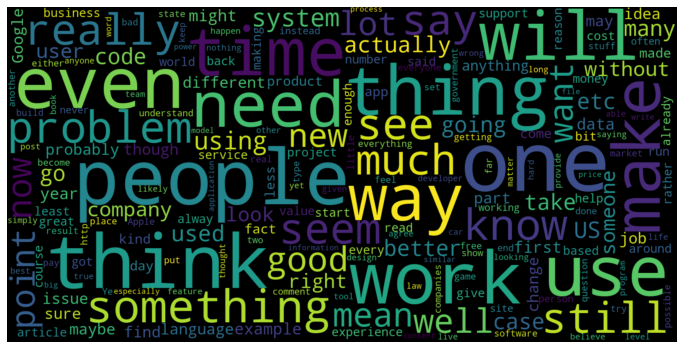

In [28]:
neg_cloud = WordCloud(width=1600, height=800,max_font_size=200).generate(neg)
plt.figure(figsize=(12,10))
plt.imshow(neg_cloud, interpolation="bilinear")
plt.axis("off")
plt.show()

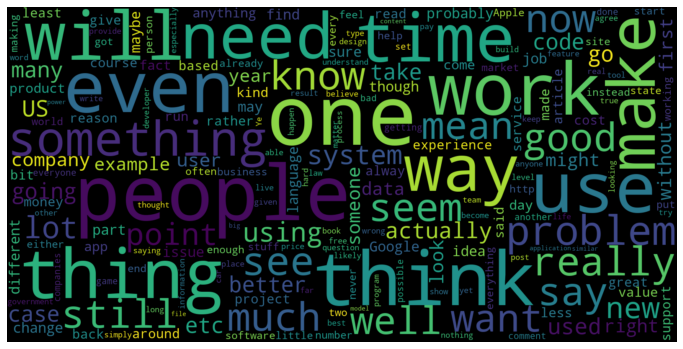

In [33]:
pos_cloud = WordCloud(width=1600, height=800,max_font_size=200).generate(neg)
plt.figure(figsize=(12,10))
plt.imshow(pos_cloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [34]:
neg

'The death threats are sort of like a DDoS attack on someone\'s life when you get thousands of them. You can go after an individual who sent a single death threat but then they\'re just an idiot who made a single death threat online, right? Well put a thousand idiots who only made a single death threat online together and you can make someone\'s life a living hell. > For me personally, 0 is the only acceptable number.But why? Surely you must acknowledge that the "innocent people murdered by the state rate" is inversely proportional to the "innocent people murdered by criminals who should have been put to death but weren\'t rate"? This latter rate includes prison murders, calling/paying for hits from prison, influencing copycat killers, being released and then killing again, etc.So basically you are trading one form of innocent death for another (not to mention introducing a host of other negative effects to society by allowing truly evil people to interact with people in said society).

In [0]:
def word_frequencies(df):
    """Returns a dict with key, value pair of word frequencies in descending order
    
    Args:
    -----
    df - pandas.DataFrame object
    """
    ngram_vectorizer = CountVectorizer(analyzer='word',
                                       ngram_range=(1, 1),
                                       min_df=1)
    
    X = ngram_vectorizer.fit_transform(df['no_stop_text'])    
    vocab = ngram_vectorizer.get_feature_names()
    counts = X.sum(axis=0).A1
    
    freqs = dict(Counter(dict(zip(vocab, counts))))    
    return freqs

In [0]:
neg_comms = df.loc[df['compound_ns'] < 0]
pos_comms = df.loc[df['compound_ns'] > 0]

In [0]:
neg_freqs = word_frequencies(neg_comms)
pos_freqs = word_frequencies(pos_comms)

In [0]:
sorted(list(neg_freqs.values()), reverse=True)

In [0]:
def count(docs):

        word_counts = Counter()
        appears_in = Counter()
        
        total_docs = len(docs)

        for doc in docs:
            word_counts.update(doc)
            appears_in.update(set(doc))

        temp = zip(word_counts.keys(), word_counts.values())
        
        wc = pd.DataFrame(temp, columns = ['word', 'count'])

        wc['rank'] = wc['count'].rank(method='first', ascending=False)
        total = wc['count'].sum()

        wc['pct_total'] = wc['count'].apply(lambda x: x / total)
        
        wc = wc.sort_values(by='rank')
        wc['cul_pct_total'] = wc['pct_total'].cumsum()

        t2 = zip(appears_in.keys(), appears_in.values())
        ac = pd.DataFrame(t2, columns=['word', 'appears_in'])
        wc = ac.merge(wc, on='word')

        wc['appears_in_pct'] = wc['appears_in'].apply(lambda x: x / total_docs)
        
        return wc.sort_values(by='rank')

In [0]:
wc_neg = count(neg_comms['no_stop_text'].str.split())
wc_pos = count(pos_comms['no_stop_text'].str.split())

In [74]:
wc_neg

,word,appears_in,count,rank,pct_total,cul_pct_total,appears_in_pct
92,people,1790,2955,1.0,0.008261,0.008261,0.311955
82,dont,1605,2224,2.0,0.006218,0.014479,0.279714
123,would,1557,2215,3.0,0.006192,0.020671,0.271349
13,one,1383,1796,4.0,0.005021,0.025692,0.241025
102,like,1393,1786,5.0,0.004993,0.030685,0.242768
...,...,...,...,...,...,...,...
41670,doesntyou,1,1,41668.0,0.000003,0.999989,0.000174
41665,alonghttpsnewsycombinatorcomitemidim,1,1,41669.0,0.000003,0.999992,0.000174
41664,sopeople,1,1,41670.0,0.000003,0.999994,0.000174
41667,threadfair,1,1,41671.0,0.000003,0.999997,0.000174


In [0]:
pos_words = wc_pos.loc[~wc_pos['word'].isin(list(wc_neg['word'].values[:20]))]

In [0]:
neg_words = wc_neg.loc[~wc_neg['word'].isin(list(wc_pos['word'].values[:20]))]

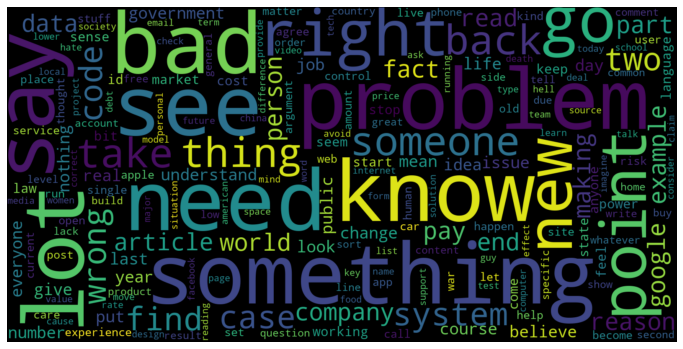

In [87]:
neg = []
for t in neg_words['word']:
    neg.append(t)
neg = pd.Series(neg).str.cat(sep=' ')

neg_cloud = WordCloud(width=1600, height=800,max_font_size=200).generate(neg)
plt.figure(figsize=(12,10))
plt.imshow(neg_cloud, interpolation="bilinear")
plt.axis("off")
plt.show()

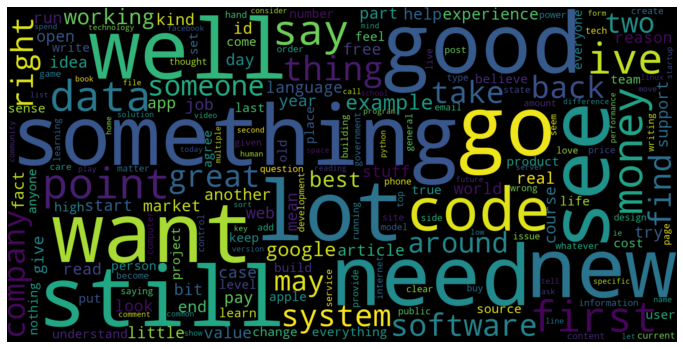

In [88]:
pos = []
for t in pos_words['word']:
    pos.append(t)
pos = pd.Series(pos).str.cat(sep=' ')

pos_cloud = WordCloud(width=1600, height=800,max_font_size=200).generate(pos)
plt.figure(figsize=(12,10))
plt.imshow(pos_cloud, interpolation="bilinear")
plt.axis("off")
plt.show()